In [2]:
import pandas as pd

In [3]:
q_311_25 = pd.read_csv('311_2025.csv')
q_311_24 = pd.read_csv('311_2024.csv')
q_311_23 = pd.read_csv('311_2023.csv')
q_311_22 = pd.read_csv('311_2022.csv')
q_311_21 = pd.read_csv('311_2021.csv')
q_311_20 = pd.read_csv('311_2020.csv')
q_311_19 = pd.read_csv('311_2019.csv')
q_311_18 = pd.read_csv('311_2018.csv')
q_311_17 = pd.read_csv('311_2017.csv')
q_311_16 = pd.read_csv('311_2016.csv')
q_311_15 = pd.read_csv('311_2015.csv')
q_311_14 = pd.read_csv('311_2014.csv')
q_311_13 = pd.read_csv('311_2013.csv')
q_311_12 = pd.read_csv('311_2012.csv')
q_311_11 = pd.read_csv('311_2011.csv')

C:\Users\surya\AppData\Local\Temp\ipykernel_58532\1552468066.py:3: DtypeWarning: Columns (13) have mixed types. Specify dtype option on import or set low_memory=False.
  q_311_23 = pd.read_csv('311_2023.csv')
C:\Users\surya\AppData\Local\Temp\ipykernel_58532\1552468066.py:4: DtypeWarning: Columns (13) have mixed types. Specify dtype option on import or set low_memory=False.
  q_311_22 = pd.read_csv('311_2022.csv')
C:\Users\surya\AppData\Local\Temp\ipykernel_58532\1552468066.py:5: DtypeWarning: Columns (13) have mixed types. Specify dtype option on import or set low_memory=False.
  q_311_21 = pd.read_csv('311_2021.csv')
C:\Users\surya\AppData\Local\Temp\ipykernel_58532\1552468066.py:6: DtypeWarning: Columns (13) have mixed types. Specify dtype option on import or set low_memory=False.
  q_311_20 = pd.read_csv('311_2020.csv')
C:\Users\surya\AppData\Local\Temp\ipykernel_58532\1552468066.py:7: DtypeWarning: Columns (13) have mixed types. Specify dtype option on import or set low_memory=Fal

In [4]:
d_25 = q_311_25[q_311_25['neighborhood'] == 'Dorchester']
d_24 = q_311_24[q_311_24['neighborhood'] == 'Dorchester']
d_23 = q_311_23[q_311_23['neighborhood'] == 'Dorchester']
d_22 = q_311_22[q_311_22['neighborhood'] == 'Dorchester']
d_21 = q_311_21[q_311_21['neighborhood'] == 'Dorchester']
d_20 = q_311_20[q_311_20['neighborhood'] == 'Dorchester']
d_19 = q_311_19[q_311_19['neighborhood'] == 'Dorchester']
d_18 = q_311_18[q_311_18['neighborhood'] == 'Dorchester']
d_17 = q_311_17[q_311_17['neighborhood'] == 'Dorchester']
d_16 = q_311_16[q_311_16['neighborhood'] == 'Dorchester']
d_15 = q_311_15[q_311_15['neighborhood'] == 'Dorchester']
d_14 = q_311_14[q_311_14['neighborhood'] == 'Dorchester']
d_13 = q_311_13[q_311_13['neighborhood'] == 'Dorchester']
d_12 = q_311_12[q_311_12['neighborhood'] == 'Dorchester']
d_11 = q_311_11[q_311_11['neighborhood'] == 'Dorchester']

In [5]:
dorchester_311 = pd.concat([d_25, d_24, d_23, d_22, d_21, d_20, d_19, d_18, d_17, d_16, d_15, d_14, d_13, d_12, d_11])

case_Stats
closure_Reason
subject
type
queue
ontime
sla_target_dt
department
source


In [6]:
len(dorchester_311)


462023

In [7]:
dorchester_311.to_csv('Dorchester_311.csv')

In [16]:
import pandas as pd
import matplotlib.pyplot as plt

# Load your dataset
# df = pd.read_csv("dorchester_311.csv")  # if CSV
# assuming you already have df loaded

# --- BASIC OVERVIEW ---
df = dorchester_311.copy()
print("Shape of dataset:", df.shape)
print("\nColumn Info:")
print(df.info())
print("\nSummary statistics for numeric columns:")
print(df.describe())

# --- MISSING VALUES ---
print("\nMissing values per column:")
print(df.isna().sum())

# --- CATEGORICAL VALUE COUNTS ---
categorical_cols = df.select_dtypes(include="object").columns
for col in categorical_cols:
    print(f"\nValue counts for {col}:")
    print(df[col].value_counts().head(10))  # top 10 only

# --- DATE FEATURES ---
if "sla_target_dt" in df.columns and "closed_dt" in df.columns:
    df["sla_target_dt"] = pd.to_datetime(df["sla_target_dt"], errors="coerce")
    df["closed_dt"] = pd.to_datetime(df["closed_dt"], errors="coerce")

    df["response_time_days"] = (df["closed_dt"] - df["sla_target_dt"]).dt.total_seconds() / (24*3600)

    print("\nResponse time stats (days):")
    print(df["response_time_days"].describe())

Shape of dataset: (462023, 30)

Column Info:
<class 'pandas.core.frame.DataFrame'>
Index: 462023 entries, 14 to 58260
Data columns (total 30 columns):
 #   Column                          Non-Null Count   Dtype  
---  ------                          --------------   -----  
 0   case_enquiry_id                 462023 non-null  int64  
 1   open_dt                         462023 non-null  object 
 2   sla_target_dt                   384725 non-null  object 
 3   closed_dt                       423471 non-null  object 
 4   on_time                         461938 non-null  object 
 5   case_status                     462023 non-null  object 
 6   closure_reason                  462023 non-null  object 
 7   case_title                      461994 non-null  object 
 8   subject                         462023 non-null  object 
 9   reason                          462023 non-null  object 
 10  type                            462023 non-null  object 
 11  queue                           462023

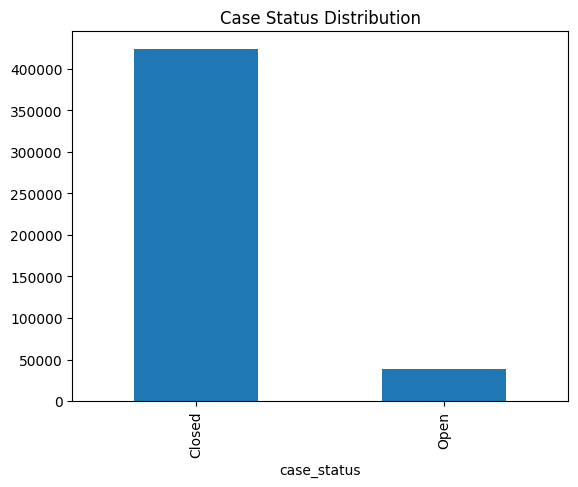

In [17]:
# Case status distribution
df["case_status"].value_counts().plot(kind="bar", title="Case Status Distribution")
plt.show()

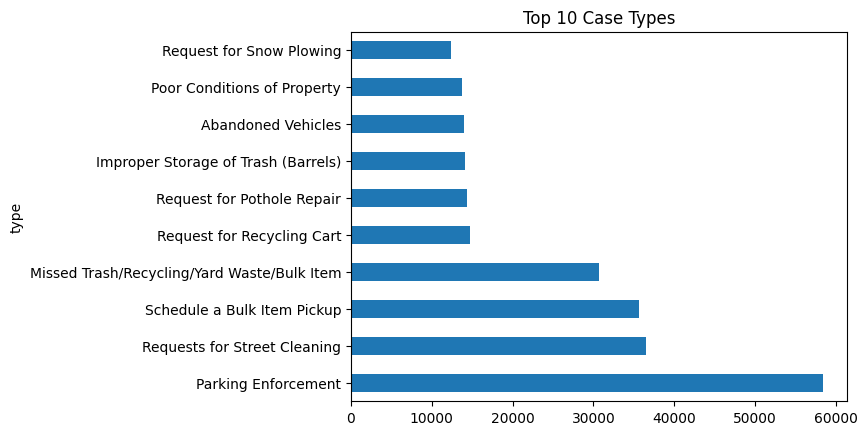

In [18]:
# Most common case types
df["type"].value_counts().head(10).plot(kind="barh", title="Top 10 Case Types")
plt.show()

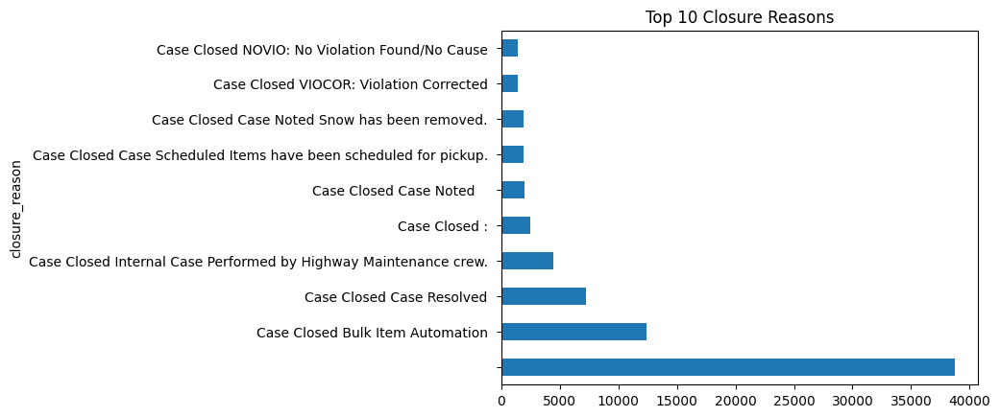

In [19]:
# Closure reasons (top 10)
df["closure_reason"].value_counts().head(10).plot(kind="barh", title="Top 10 Closure Reasons")
plt.show()

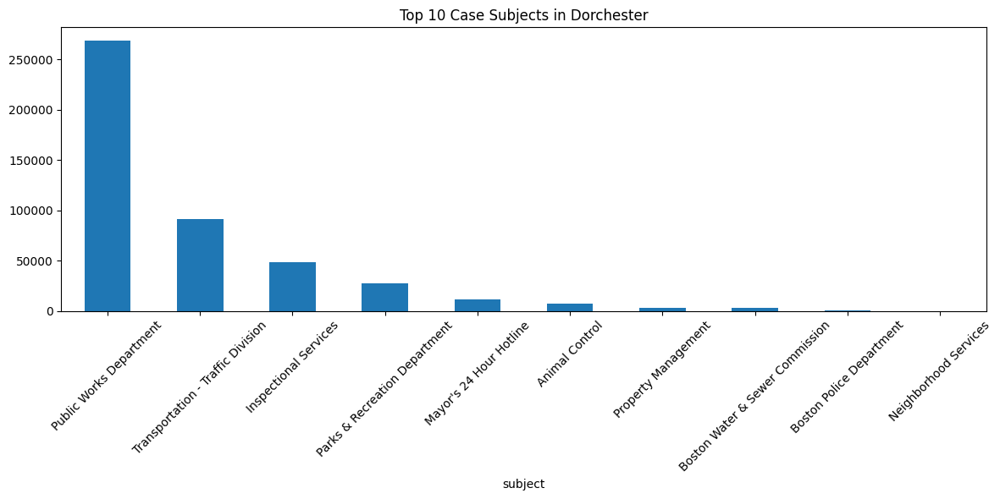

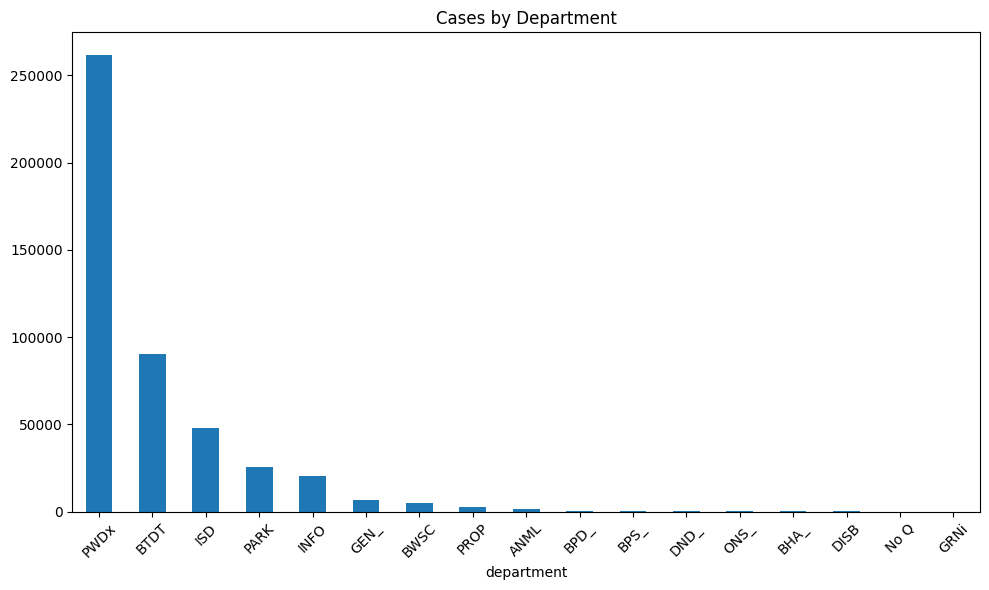

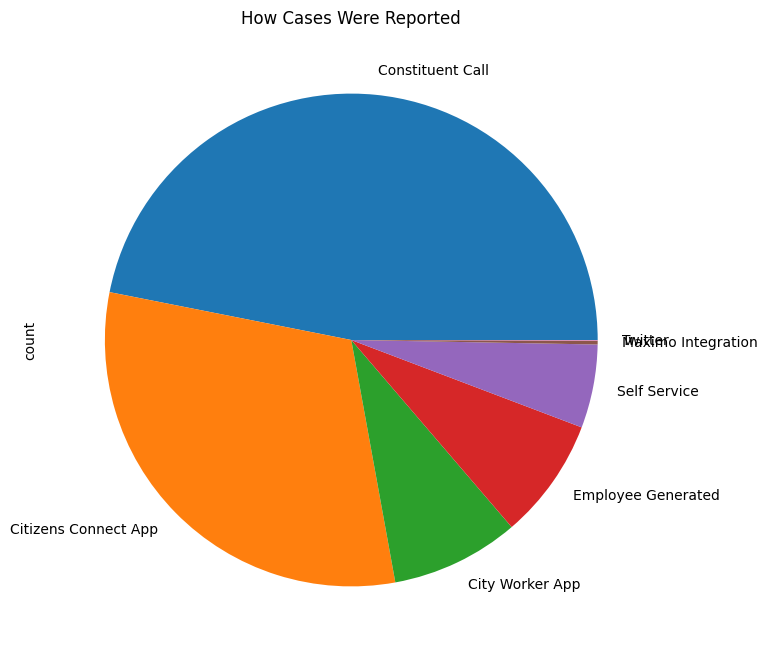

In [20]:
# More meaningful visualizations instead of police district codes

# Cases by subject (what the issue is about)
df["subject"].value_counts().head(10).plot(kind="bar", title="Top 10 Case Subjects in Dorchester", figsize=(12,6))
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

# Cases by department handling them
df["department"].value_counts().plot(kind="bar", title="Cases by Department", figsize=(10,6))
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

# Cases by source (how people reported)
df["source"].value_counts().plot(kind="pie", title="How Cases Were Reported", figsize=(8,8))
plt.show()

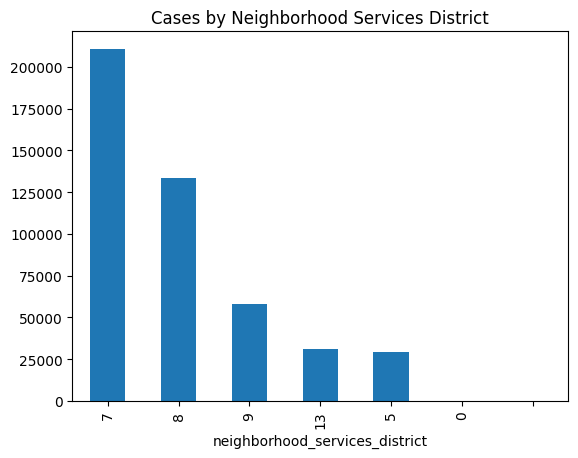

In [21]:
# Calls by neighborhood services district
df["neighborhood_services_district"].value_counts().plot(kind="bar", title="Cases by Neighborhood Services District")
plt.show()

In [22]:
dorchester_311.columns

Index(['case_enquiry_id', 'open_dt', 'sla_target_dt', 'closed_dt', 'on_time', 'case_status', 'closure_reason', 'case_title', 'subject', 'reason', 'type', 'queue', 'department', 'submitted_photo',
       'closed_photo', 'location', 'fire_district', 'pwd_district', 'city_council_district', 'police_district', 'neighborhood', 'neighborhood_services_district', 'ward', 'precinct',
       'location_street_name', 'location_zipcode', 'latitude', 'longitude', 'geom_4326', 'source'],
      dtype='object')

In [25]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np

sns.set(style="whitegrid", palette="muted", font_scale=1.1)

# Load dataset
df = dorchester_311.copy()

# Parse dates
for col in ["open_dt", "sla_target_dt", "closed_dt"]:
    df[col] = pd.to_datetime(df[col], errors="coerce")

# Time features
df["year"] = df["open_dt"].dt.year
df["month"] = df["open_dt"].dt.month
df["day_of_week"] = df["open_dt"].dt.day_name()
df["hour"] = df["open_dt"].dt.hour

# Response time (days)
df["response_time_days_open_closed"] = (
    (df["closed_dt"] - df["open_dt"]).dt.total_seconds() / (3600 * 24)
)


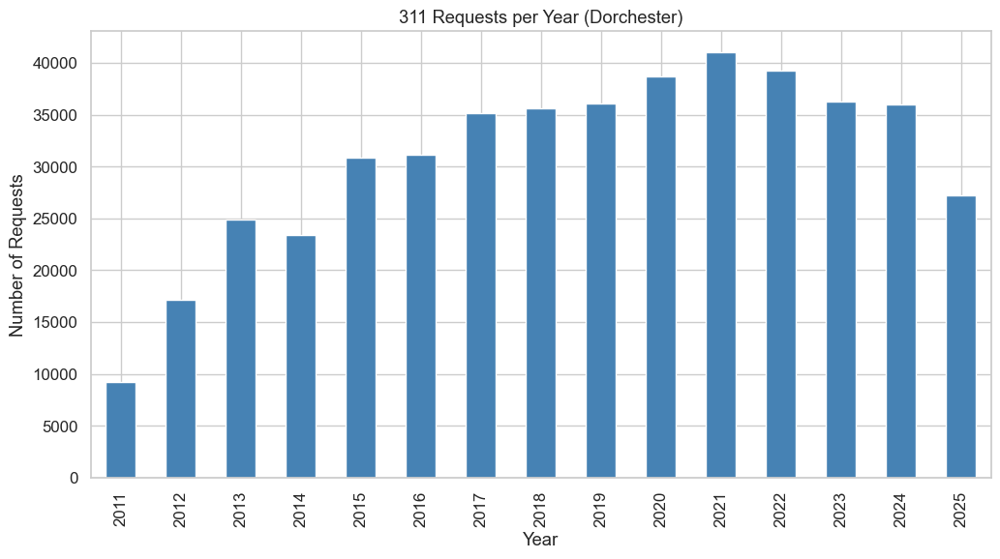

In [26]:
plt.figure(figsize=(12,6))
df["year"].value_counts().sort_index().plot(kind="bar", color="steelblue")
plt.title("311 Requests per Year (Dorchester)")
plt.xlabel("Year")
plt.ylabel("Number of Requests")
plt.show()


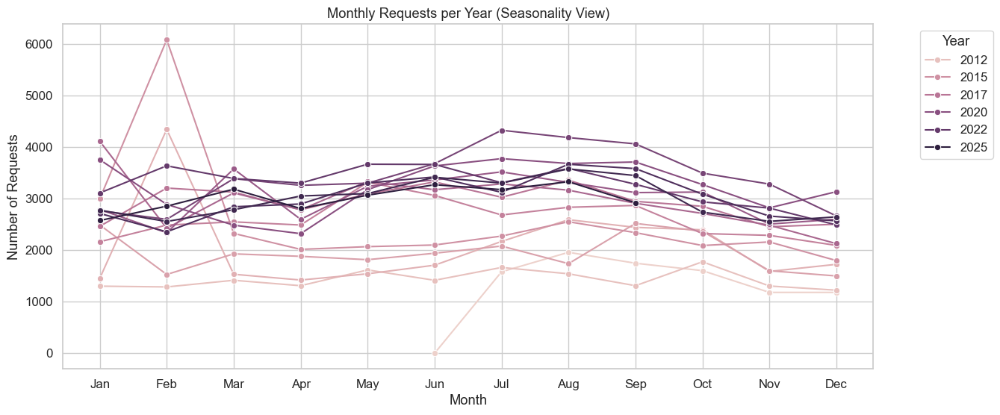

In [31]:
monthly_year = df.groupby([df["year"], df["month"]]).size().reset_index(name="count")

plt.figure(figsize=(14,6))
sns.lineplot(x="month", y="count", hue="year", data=monthly_year, marker="o")
plt.title("Monthly Requests per Year (Seasonality View)")
plt.xlabel("Month")
plt.ylabel("Number of Requests")
plt.xticks(range(1,13), 
           ["Jan","Feb","Mar","Apr","May","Jun","Jul","Aug","Sep","Oct","Nov","Dec"])
plt.legend(title="Year", bbox_to_anchor=(1.05,1), loc="upper left")
plt.show()



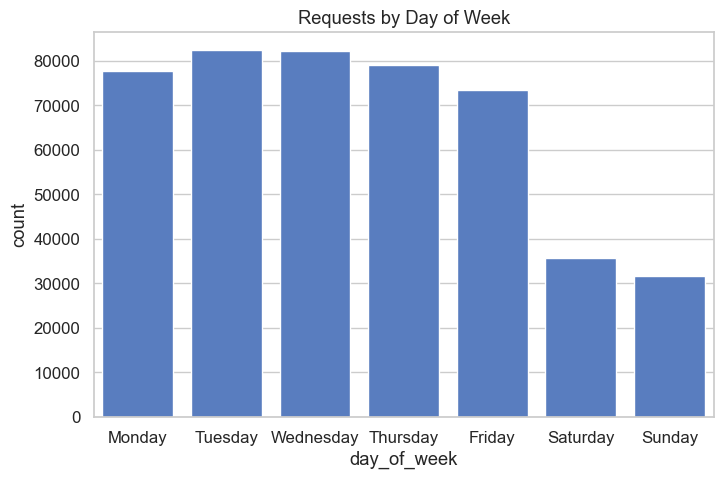

In [28]:
plt.figure(figsize=(8,5))
sns.countplot(x="day_of_week", data=df,
              order=["Monday","Tuesday","Wednesday","Thursday","Friday","Saturday","Sunday"])
plt.title("Requests by Day of Week")
plt.show()


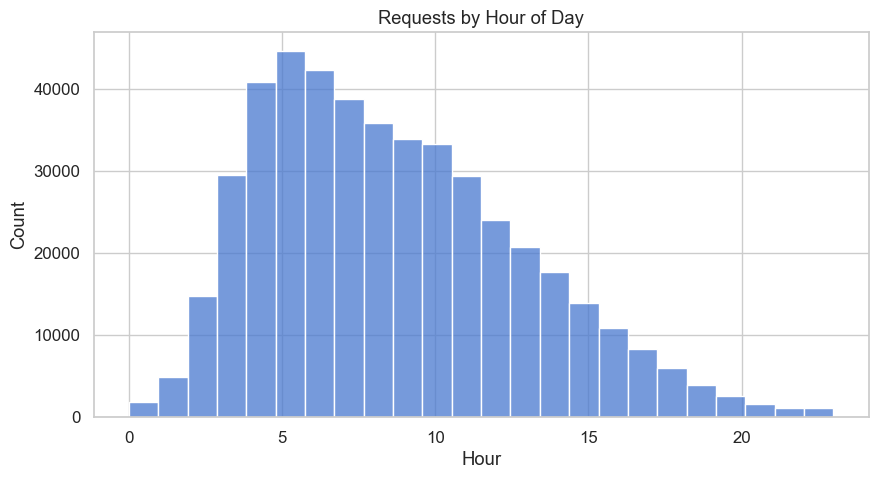

In [29]:
plt.figure(figsize=(10,5))
sns.histplot(df["hour"].dropna(), bins=24, kde=False)
plt.title("Requests by Hour of Day")
plt.xlabel("Hour")
plt.show()


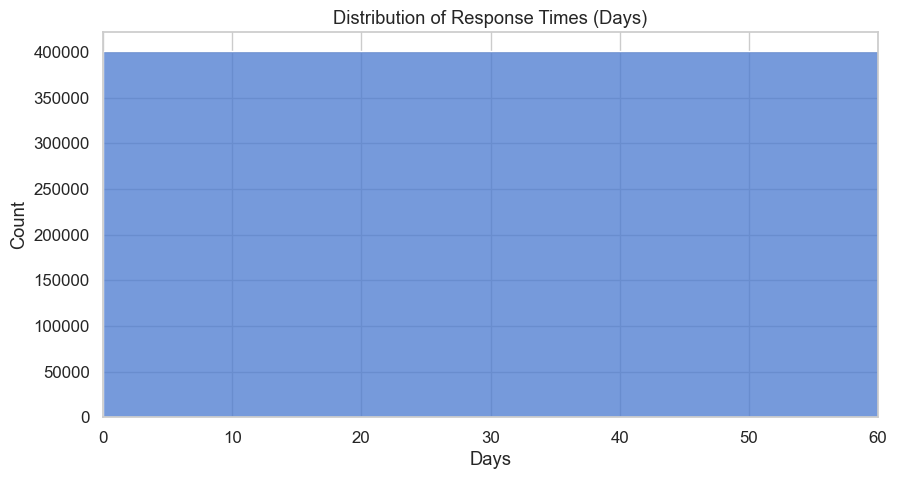

In [30]:
plt.figure(figsize=(10,5))
sns.histplot(df["response_time_days_open_closed"].dropna(), bins=50)
plt.title("Distribution of Response Times (Days)")
plt.xlabel("Days")
plt.xlim(0,60)   # cap at 60 days
plt.show()


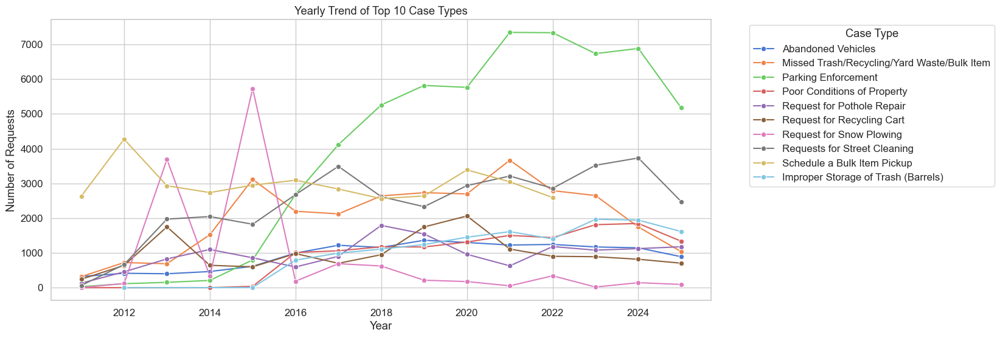

In [32]:
top_types = df["type"].value_counts().head(10).index
yearly_types = df[df["type"].isin(top_types)].groupby(["year","type"]).size().reset_index(name="count")

plt.figure(figsize=(14,6))
sns.lineplot(x="year", y="count", hue="type", data=yearly_types, marker="o")
plt.title("Yearly Trend of Top 10 Case Types")
plt.xlabel("Year")
plt.ylabel("Number of Requests")
plt.legend(title="Case Type", bbox_to_anchor=(1.05,1), loc="upper left")
plt.show()


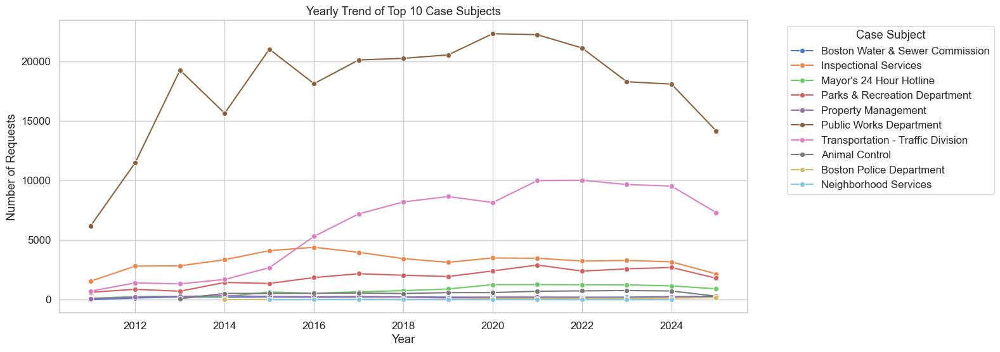

In [33]:
top_subjects = df["subject"].value_counts().head(10).index
yearly_subjects = df[df["subject"].isin(top_subjects)].groupby(["year","subject"]).size().reset_index(name="count")

plt.figure(figsize=(14,6))
sns.lineplot(x="year", y="count", hue="subject", data=yearly_subjects, marker="o")
plt.title("Yearly Trend of Top 10 Case Subjects")
plt.xlabel("Year")
plt.ylabel("Number of Requests")
plt.legend(title="Case Subject", bbox_to_anchor=(1.05,1), loc="upper left")
plt.show()


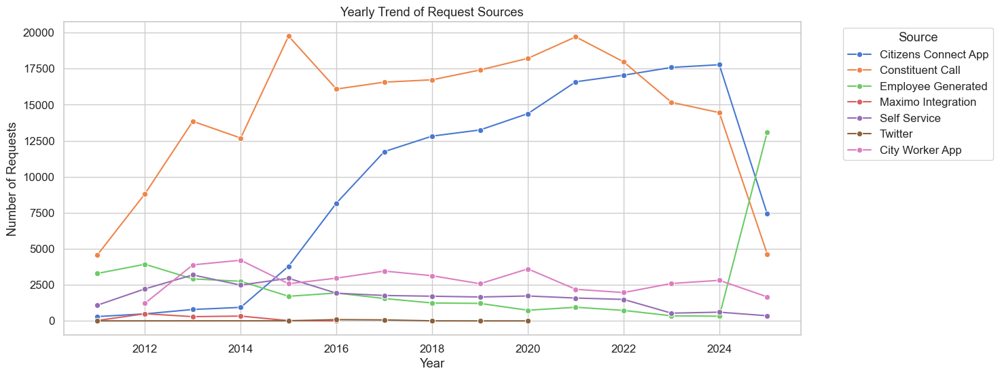

In [34]:
top_sources = df["source"].value_counts().head(8).index
yearly_sources = df[df["source"].isin(top_sources)].groupby(["year","source"]).size().reset_index(name="count")

plt.figure(figsize=(14,6))
sns.lineplot(x="year", y="count", hue="source", data=yearly_sources, marker="o")
plt.title("Yearly Trend of Request Sources")
plt.xlabel("Year")
plt.ylabel("Number of Requests")
plt.legend(title="Source", bbox_to_anchor=(1.05,1), loc="upper left")
plt.show()


In [35]:
import folium
from folium.plugins import HeatMap

# Center Dorchester (roughly)
m = folium.Map(location=[42.29, -71.07], zoom_start=13, tiles="cartodbpositron")

# Heatmap layer
heat_data = df[["latitude","longitude"]].dropna().values.tolist()
HeatMap(heat_data, radius=8, blur=12).add_to(m)

m


In [36]:
top_streets = df["location_street_name"].value_counts().head(15)

m2 = folium.Map(location=[42.29, -71.07], zoom_start=13, tiles="cartodbpositron")

for street, count in top_streets.items():
    subset = df[df["location_street_name"] == street].dropna(subset=["latitude","longitude"])
    if not subset.empty:
        lat, lon = subset.iloc[0][["latitude","longitude"]]
        folium.CircleMarker(
            location=[lat, lon],
            radius=6 + count/200, # scale by count
            color="red",
            fill=True,
            fill_opacity=0.6,
            popup=f"{street}: {count} requests"
        ).add_to(m2)

m2


In [37]:
m3 = folium.Map(location=[42.29, -71.07], zoom_start=13, tiles="cartodbpositron")

heat_overdue = df[df["on_time"]=="OVERDUE"][["latitude","longitude"]].dropna().values.tolist()
HeatMap(heat_overdue, radius=8, blur=12, gradient={0.2:"blue",0.5:"orange",0.8:"red"}).add_to(m3)

m3


In [38]:
map_center = [df["latitude"].mean(), df["longitude"].mean()]
case_type = "Abandoned Vehicles"  # change this to any case type

m = folium.Map(location=map_center, zoom_start=13)

heat_data = df[df["type"] == case_type][["latitude", "longitude"]].dropna().values.tolist()
HeatMap(heat_data, radius=10, blur=15, max_zoom=13).add_to(m)

m


In [1]:
top_types = df["type"].value_counts().nlargest(5).index

for t in top_types:
    m = folium.Map(location=map_center, zoom_start=13)
    heat_data = df[df["type"] == t][["latitude", "longitude"]].dropna().values.tolist()
    HeatMap(heat_data, radius=10, blur=15).add_to(m)
    display(m)   # <-- forces Jupyter to render each map


NameError: name 'df' is not defined

In [ ]:
from folium.plugins import MarkerCluster

m = folium.Map(location=map_center, zoom_start=13)
marker_cluster = MarkerCluster().add_to(m)

top_types = df["type"].value_counts().nlargest(5).index
colors = ["red", "blue", "green", "purple", "orange"]

for t, c in zip(top_types, colors):
    subset = df[df["type"] == t][["latitude", "longitude"]].dropna()
    for _, row in subset.iterrows():
        folium.CircleMarker(
            location=[row["latitude"], row["longitude"]],
            radius=3,
            color=c,
            fill=True,
            fill_opacity=0.5,
            popup=f"Type: {t}"
        ).add_to(marker_cluster)

m
